In [1]:
from gammaALPs.core import Source, ALP, ModuleList
from gammaALPs.base import environs, transfer
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patheffects import withStroke
from ebltable.tau_from_model import OptDepth
from astropy import constants as c
%matplotlib inline
from scipy import interpolate
import scipy.interpolate as spi

In [36]:
m_array = np.logspace(-1,1,10)
g_array = np.logspace(np.log10(0.5),np.log10(5),10)
# EGeV = np.logspace(-1,3.5,250)

In [37]:
def P(mass=1,g=0.5,B0=1e4,n0=1e5,nsim=10,r_core=1e-4,q=-2.80,gamma_min=1,Rjet=10,beta=-2,gamma_max=np.exp(10.),EGeV = np.logspace(-1,3.5,250)):
    src = Source(z = 0.002 , ra = '02h42m41s', dec = '+00d00m48s')
    EGeV = EGeV
    alp = ALP(mass,g)
    pin = np.diag((1.,1.,0.)) * 0.5
    
    m = ModuleList(alp, src, pin = pin, EGeV = EGeV)

    m.add_propagation("ICMGaussTurb", 
                      0, # position of module counted from the source. 
                      nsim = nsim, # number of random B-field realizations
                      B0 = B0,  # rms of B field
                      n0 = n0,  # normalization of electron density
    #                   n2 = 4.05, # second normalization of electron density, see Churazov et al. 2003, Eq. 4
                      r_abell = 500., # extension of the cluster
                      r_core = r_core,   # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   r_core2 = 280., # electron density parameter, see Churazov et al. 2003, Eq. 4
                      beta = 1.2,  # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   beta2= 0.58, # electron density parameter, see Churazov et al. 2003, Eq. 4
                      eta = 0.5, # scaling of B-field with electron denstiy
                      kL = 0.18, # maximum turbulence scale in kpc^-1, taken from A2199 cool-core cluster, see Vacca et al. 2012 
                      kH = 9.,  # minimum turbulence scale, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      q = q, # turbulence spectral index, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      seed=0 # random seed for reproducability, set to None for random seed.
                     )
    m.add_propagation("EBL",1, model = 'dominguez') # EBL attenuation comes second, after beam has left cluster
    m.add_propagation("GMF",2, model = 'jansson12', model_sum = 'ASS') # finally, the beam enters the Milky Way Field

    m.add_propagation("Jet",
                      0,  # position of module counted from the source.
                      B0=B0,  # Jet field at r = R0 in G
                      r0=r_core,  # distance from BH where B = B0 in pc
                      rgam=r_core, #1e15 * u.cm.to('pc'),  # distance of gamma-ray emitting region to BH
                      alpha=-1.,  # exponent of toroidal mangetic field (default: -1.)
                      psi=np.pi/4.,  # Angle between one photon polarization state and B field.
                                     # Assumed constant over entire jet.
                      helical=True,  # if True, use helical magnetic-field model from Clausen-Brown et al. (2011).
                                     # In this case, the psi kwarg is treated is as the phi angle
                                     # of the photon trajectory in the cylindrical jet coordinate system
                      equipartition=True,  # if true, assume equipartition between electrons and the B field.
                                           # This will overwrite the exponent of electron density beta = 2 * alpha
                                           # and set n0 given the minimum electron lorentz factor set with gamma_min
                      gamma_min=gamma_min,  # minimum lorentz factor of emitting electrons, only used if equipartition=True
                      gamma_max=gamma_max * gamma_min,  # maximum lorentz factor of emitting electrons,
                                                          # only used if equipartition=True
                      Rjet= Rjet,  # maximum jet length in pc (default: 1000.)
                      n0=n0,  # normalization of electron density, overwritten if equipartition=True
                      beta=-2.    # power-law index of electron density, overwritten if equipartition=True
                     )
    px,py,pa = m.run(multiprocess=2)
    pgg = px + py # the total photon survival probability
    return m.EGeV,pgg


def calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_1e4Rs.csv', mass=1, g=0.5, B0=1e4, n0=1e5, nsim=10, r_core=1e-4, q=-2.80, gamma_min=1, Rjet=10, beta=-2, gamma_max=np.exp(10),rgam=1e-1,EGeV = np.logspace(-1, 3.5, 250)):
    src = Source(z=0.002, ra='02h42m41s', dec='+00d00m48s')
    EGeV = EGeV
    alp = ALP(mass, g)
    pin = np.diag((1.,1.,0.)) * 0.5    
    
    file_path = file
    flux_data = pd.read_csv(file_path)
    # Extracting the columns for interpolation
    x_values = flux_data['x']  # Photon energy
    y_values = flux_data['Curve1']  # Flux of photons
    # Creating the interpolation function
    interpolated_flux = spi.interp1d(x_values, y_values, kind='cubic', fill_value="extrapolate")
    
    
    m = ModuleList(alp, src, pin = pin, EGeV = EGeV)
    m.add_propagation("ICMGaussTurb", 
                      0, # position of module counted from the source. 
                      nsim = nsim, # number of random B-field realizations
                      B0 = B0,  # rms of B field
                      n0 = n0,  # normalization of electron density
    #                   n2 = 4.05, # second normalization of electron density, see Churazov et al. 2003, Eq. 4
                      r_abell = 500., # extension of the cluster
                      r_core = r_core,   # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   r_core2 = 280., # electron density parameter, see Churazov et al. 2003, Eq. 4
                      beta = 1.2,  # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   beta2= 0.58, # electron density parameter, see Churazov et al. 2003, Eq. 4
                      eta = 0.5, # scaling of B-field with electron denstiy
                      kL = 0.18, # maximum turbulence scale in kpc^-1, taken from A2199 cool-core cluster, see Vacca et al. 2012 
                      kH = 9.,  # minimum turbulence scale, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      q = q, # turbulence spectral index, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      seed=0 # random seed for reproducability, set to None for random seed.
                     )
    m.add_propagation("EBL",1, model = 'dominguez') # EBL attenuation comes second, after beam has left cluster
    m.add_propagation("GMF",2, model = 'jansson12', model_sum = 'ASS') # finally, the beam enters the Milky Way Field

    m.add_propagation("Jet",
                      0,  # position of module counted from the source.
                      B0=B0,  # Jet field at r = R0 in G
                      r0=r_core,  # distance from BH where B = B0 in pc
                      rgam=rgam, #1e15 * u.cm.to('pc'),  # distance of gamma-ray emitting region to BH
                      alpha=-1.,  # exponent of toroidal mangetic field (default: -1.)
                      psi=np.pi/4.,  # Angle between one photon polarization state and B field.
                                     # Assumed constant over entire jet.
                      helical=True,  # if True, use helical magnetic-field model from Clausen-Brown et al. (2011).
                                     # In this case, the psi kwarg is treated is as the phi angle
                                     # of the photon trajectory in the cylindrical jet coordinate system
                      equipartition=True,  # if true, assume equipartition between electrons and the B field.
                                           # This will overwrite the exponent of electron density beta = 2 * alpha
                                           # and set n0 given the minimum electron lorentz factor set with gamma_min
                      gamma_min=gamma_min,  # minimum lorentz factor of emitting electrons, only used if equipartition=True
                      gamma_max=gamma_max * gamma_min,  # maximum lorentz factor of emitting electrons,
                                                          # only used if equipartition=True
                      Rjet= Rjet,  # maximum jet length in pc (default: 1000.)
                      n0=n0,  # normalization of electron density, overwritten if equipartition=True
                      beta=-2.    # power-law index of electron density, overwritten if equipartition=True
                     )
    px,py,pa = m.run(multiprocess=2)
    pgg = px + py # the total photon survival probability    
    
    products = np.multiply(pgg,interpolated_flux(EGeV))
   
    return EGeV,pgg,products

In [38]:
# Fermi data
import pandas as pd

data_central = pd.read_csv('data/NGC1068_FLat_central_values.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_central = data_central['Energy_GeV']
Flux_central = data_central['emission']

data_low = pd.read_csv('data/NGC1068_FLat_lower_errors.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_low = data_low['Energy_GeV']
Flux_low = data_low['emission']

data_up = pd.read_csv('data/NGC1068_FLat_upper_errors.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_up = data_up['Energy_GeV']
Flux_up = data_up['emission']


In [39]:
##### STATISTICAL ANALYSIS

import scipy.stats as stats

# Defining the parameter ranges for exploration
m_array = np.logspace(-1,1,10)
# m_array = np.array([1])
g_array = np.logspace(np.log10(0.01),np.log10(10),50)

# Eventually add magnetic fields etc.. 
u_Cr_range = np.linspace(-0.02, 0.02, 5)  # A few representative points in the range of u_Cr


# Function to calculate chi-squared
# def calculate_chi_squared(m, g, u_Cr):
def calculate_chi_squared(m, g):    
    model_prediction = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=m, g=g,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV=np.array([E_GeV_central])[0][:-10])[2]
    observed_errors = abs(np.array(Flux_up)[:-10]-np.array(Flux_central)[:-10]) # Check
    observed_errors = np.sqrt((abs(np.array(Flux_up)[:-10]-np.array(Flux_central)[:-10])**2)+(abs(np.array(Flux_low)[:-10]-np.array(Flux_central)[:-10])**2))
    observed_counts = np.array(Flux_central)[:-10]
    chi_squared = np.sum(((observed_counts - model_prediction) / observed_errors) ** 2)
    return chi_squared

# Grid search over the parameter space
chi_squared_results = np.zeros((len(m_array), len(g_array)))

for i in range(len(m_array)):
    for j in range(len(g_array)):
        # Averaging over the u_Cr range
#         chi_squared_values = [calculate_chi_squared(m_array, g_array, u_Cr, mock_data_counts, errors_mock, bin_edges) for u_Cr in u_Cr_range]
        chi_squared_values = calculate_chi_squared(m_array[i], g_array[j])       
#         chi_squared_results[i, j] = np.mean(chi_squared_values)
        chi_squared_results[i, j] = chi_squared_values # Only mean for u_Cr      

# Obtaining the minimum chi-squared value
min_chi_squared = np.min(chi_squared_results)

chi_squared_results_normalized = chi_squared_results-np.min(chi_squared_results)

# Calculating the 1 sigma and 2 sigma levels (Delta chi-squared for 2 degrees of freedom)
delta_chi_squared_1sigma = stats.chi2.ppf(0.6827, 2) - stats.chi2.ppf(0.5, 2)  # 1 sigma
delta_chi_squared_2sigma = stats.chi2.ppf(0.9545, 2) - stats.chi2.ppf(0.5, 2)  # 2 sigma

# Finding the 1 sigma and 2 sigma contours
contour_1sigma = min_chi_squared + delta_chi_squared_1sigma
contour_2sigma = min_chi_squared + delta_chi_squared_2sigma

environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi


environs.py:1196 --- INFO: Using inputted chi


environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3


environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>


/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>


   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>


   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")
environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi


   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


(1e-12, 1e-06)

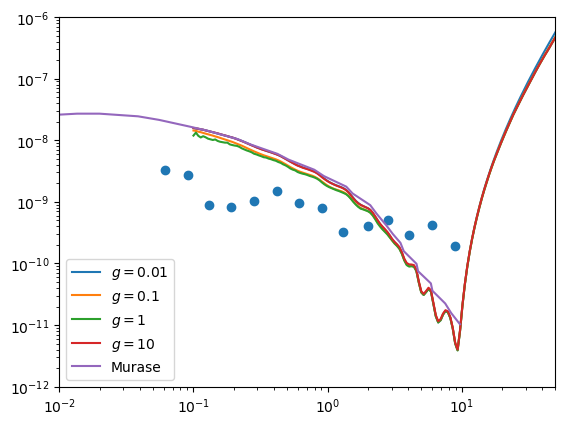

In [23]:
g = 0.01
m = 1
Flux_ = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=m, g=g,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV= np.logspace(-1,3.5,250))[2]
plt.loglog(np.logspace(-1,3.5,250),Flux_[0],label=r'$g=0.01$')

g = 0.1
m = 1
Flux_ = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=m, g=g,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV= np.logspace(-1,3.5,250))[2]
plt.loglog(np.logspace(-1,3.5,250),Flux_[0],label=r'$g=0.1$')

g = 1
m = 1
Flux_ = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=m, g=g,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV= np.logspace(-1,3.5,250))[2]
plt.loglog(np.logspace(-1,3.5,250),Flux_[0],label=r'$g=1$')

g = 1
m = 10
Flux_ = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=m, g=g,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV= np.logspace(-1,3.5,250))[2]
plt.loglog(np.logspace(-1,3.5,250),Flux_[0],label=r'$g=10$')




plt.scatter(E_GeV_central[:-10],Flux_central[:-10])
plt.yscale('log')
plt.xscale('log')

file_path = 'Murase_2211.04460/NGC1068cascadepg_300Rs.csv'
flux_data = pd.read_csv(file_path)
x_values = flux_data['x']  # Photon energy
y_values = flux_data['Curve1']  # Flux of photons
plt.loglog(x_values,y_values,label='Murase')
plt.legend()
plt.xlim(1e-2,50)
plt.ylim(1e-12,1e-6)

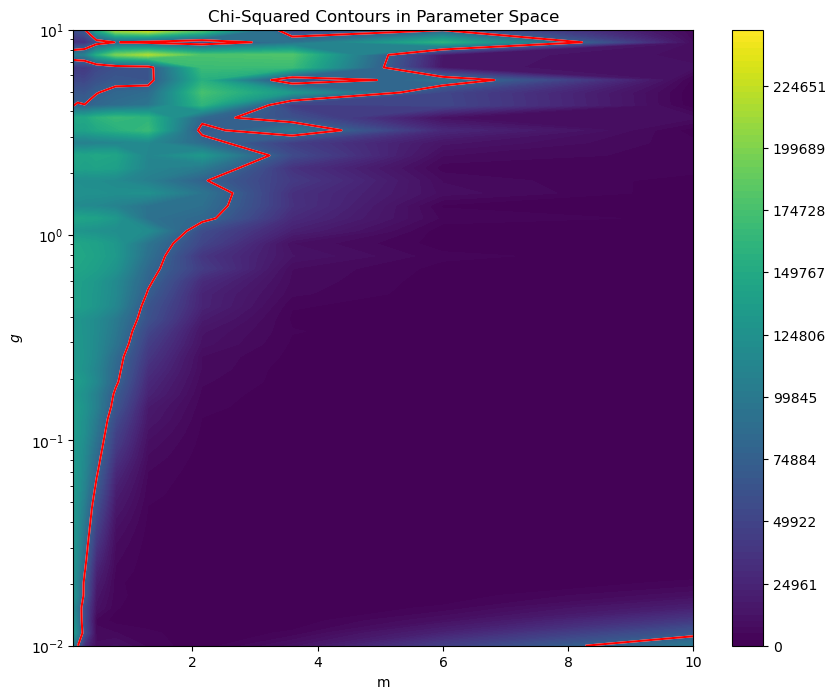

(74135.33612043087, 0.9095207996660826, 4.793791544930574)

In [40]:
# Preparing for plotting
X, Y = np.meshgrid(m_array, g_array)
Z = chi_squared_results_normalized.T  # Transpose to align the axes correctly

# Plotting the chi-squared map and contours
plt.figure(figsize=(10, 8))
cp = plt.contourf(X, Y, Z, levels=np.linspace(Z.min(), Z.max(), 100), cmap='viridis')
plt.colorbar(cp)
plt.contour(X, Y, Z, levels=[contour_1sigma, contour_2sigma], colors=['white', 'red'])
plt.xscale('linear')
plt.yscale('log')
plt.xlabel(r'm')
plt.ylabel(r'$g$')
plt.title(r'Chi-Squared Contours in Parameter Space')
plt.show()

# Returning the minimum chi-squared value for reference
min_chi_squared, delta_chi_squared_1sigma, delta_chi_squared_2sigma

#plt.savefig('chi2_anapole_sin2thetaW.pdf')

In [41]:
m_array

array([ 0.1       ,  0.16681005,  0.27825594,  0.46415888,  0.77426368,
        1.29154967,  2.15443469,  3.59381366,  5.9948425 , 10.        ])

environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+11 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
 legend.py:1363 --- WARNING: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


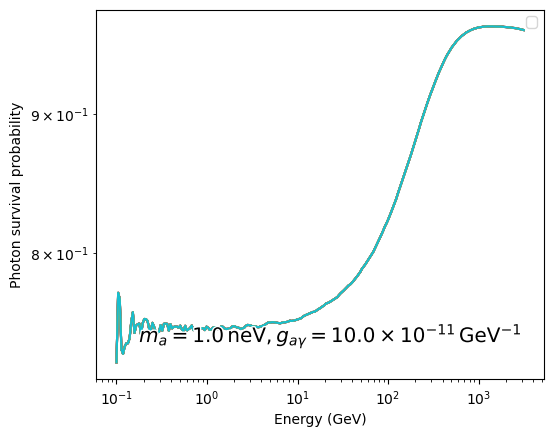

In [45]:
E,pgg = P()

effect = dict(path_effects=[withStroke(foreground="w", linewidth=2)])

for p in pgg: # plot all realizations
    plt.semilogx(E, p)

plt.xlabel('Energy (GeV)')
plt.ylabel('Photon survival probability')

plt.gca().set_xscale('log')
plt.gca().set_yscale('log')
plt.subplots_adjust(left = 0.2)
# plt.savefig("pgg.png", dpi = 150)
plt.show()

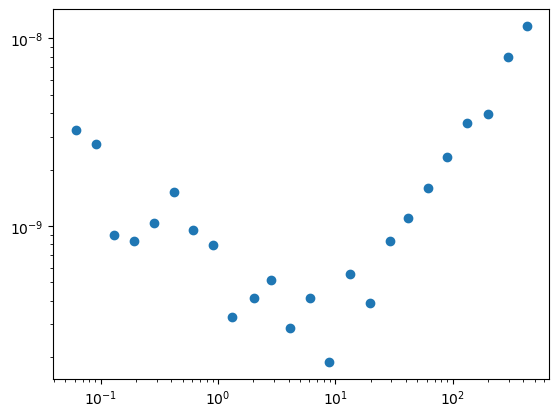

In [137]:
import pandas as pd

data_central = pd.read_csv('data/NGC1068_FLat_central_values.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_central = data['Energy_GeV']
Flux_central = data['emission']

data_low = pd.read_csv('data/NGC1068_FLat_lower_errors.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_low = data['Energy_GeV']
Flux_low = data['emission']

data_up = pd.read_csv('data/NGC1068_FLat_upper_errors.csv', header=0, index_col=False, engine='python', na_values='-',delim_whitespace=False)
E_GeV_up = data['Energy_GeV']
Flux_up = data['emission']

plt.scatter(E_GeV_central,Flux_central)
plt.xscale('log')
plt.yscale('log')
plt.show()

In [124]:
# Modified function to calculate the product for each energy in the EGeV range used by the photon-axion conversion probability calculation

def calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_1e4Rs.csv', mass=1, g=0.5, B0=1e4, n0=1e5, nsim=10, r_core=1e-4, q=-2.80, gamma_min=1, Rjet=10, beta=-2, gamma_max=np.exp(10),rgam=1e-1,EGeV = np.logspace(-1, 3.5, 250)):
    src = Source(z=0.002, ra='02h42m41s', dec='+00d00m48s')
    EGeV = EGeV
    alp = ALP(mass, g)
    pin = np.diag((1.,1.,0.)) * 0.5    
    
    file_path = file
    flux_data = pd.read_csv(file_path)
    # Extracting the columns for interpolation
    x_values = flux_data['x']  # Photon energy
    y_values = flux_data['Curve1']  # Flux of photons
    # Creating the interpolation function
    interpolated_flux = spi.interp1d(x_values, y_values, kind='cubic', fill_value="extrapolate")
    
    
    m = ModuleList(alp, src, pin = pin, EGeV = EGeV)
    m.add_propagation("ICMGaussTurb", 
                      0, # position of module counted from the source. 
                      nsim = nsim, # number of random B-field realizations
                      B0 = B0,  # rms of B field
                      n0 = n0,  # normalization of electron density
    #                   n2 = 4.05, # second normalization of electron density, see Churazov et al. 2003, Eq. 4
                      r_abell = 500., # extension of the cluster
                      r_core = r_core,   # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   r_core2 = 280., # electron density parameter, see Churazov et al. 2003, Eq. 4
                      beta = 1.2,  # electron density parameter, see Churazov et al. 2003, Eq. 4
    #                   beta2= 0.58, # electron density parameter, see Churazov et al. 2003, Eq. 4
                      eta = 0.5, # scaling of B-field with electron denstiy
                      kL = 0.18, # maximum turbulence scale in kpc^-1, taken from A2199 cool-core cluster, see Vacca et al. 2012 
                      kH = 9.,  # minimum turbulence scale, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      q = q, # turbulence spectral index, taken from A2199 cool-core cluster, see Vacca et al. 2012
                      seed=0 # random seed for reproducability, set to None for random seed.
                     )
    m.add_propagation("EBL",1, model = 'dominguez') # EBL attenuation comes second, after beam has left cluster
    m.add_propagation("GMF",2, model = 'jansson12', model_sum = 'ASS') # finally, the beam enters the Milky Way Field

    m.add_propagation("Jet",
                      0,  # position of module counted from the source.
                      B0=B0,  # Jet field at r = R0 in G
                      r0=r_core,  # distance from BH where B = B0 in pc
                      rgam=rgam, #1e15 * u.cm.to('pc'),  # distance of gamma-ray emitting region to BH
                      alpha=-1.,  # exponent of toroidal mangetic field (default: -1.)
                      psi=np.pi/4.,  # Angle between one photon polarization state and B field.
                                     # Assumed constant over entire jet.
                      helical=True,  # if True, use helical magnetic-field model from Clausen-Brown et al. (2011).
                                     # In this case, the psi kwarg is treated is as the phi angle
                                     # of the photon trajectory in the cylindrical jet coordinate system
                      equipartition=True,  # if true, assume equipartition between electrons and the B field.
                                           # This will overwrite the exponent of electron density beta = 2 * alpha
                                           # and set n0 given the minimum electron lorentz factor set with gamma_min
                      gamma_min=gamma_min,  # minimum lorentz factor of emitting electrons, only used if equipartition=True
                      gamma_max=gamma_max * gamma_min,  # maximum lorentz factor of emitting electrons,
                                                          # only used if equipartition=True
                      Rjet= Rjet,  # maximum jet length in pc (default: 1000.)
                      n0=n0,  # normalization of electron density, overwritten if equipartition=True
                      beta=-2.    # power-law index of electron density, overwritten if equipartition=True
                     )
    px,py,pa = m.run(multiprocess=2)
    pgg = px + py # the total photon survival probability    
    
    products = np.multiply(pgg,interpolated_flux(EGeV))
   
    return EGeV,pgg,products

In [125]:
np.array([E_GeV_central])[0]

array([6.11580746e-02, 9.03808853e-02, 1.30208876e-01, 1.90501732e-01,
       2.82049733e-01, 4.17892141e-01, 6.10288200e-01, 9.01864625e-01,
       1.31454461e+00, 2.00909729e+00, 2.82134993e+00, 4.07446926e+00,
       6.03683848e+00, 8.89647931e+00, 1.32236498e+01, 1.97343906e+01,
       2.89827263e+01, 4.15813310e+01, 6.09573859e+01, 8.93656646e+01,
       1.32431482e+02, 1.98053467e+02, 2.97010241e+02, 4.26311912e+02])

In [60]:
output = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=0.1,g=0.7,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3,EGeV=np.array([E_GeV_central])[0])


environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+11 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


In [61]:
output[2]

array([[2.02039301e-08, 1.67243362e-08, 1.39255219e-08, 1.11633213e-08,
        7.98581902e-09, 5.97486117e-09, 3.94175190e-09, 2.72140050e-09,
        1.79241759e-09, 8.39744781e-10, 3.08165774e-10, 7.40091144e-11,
        2.70608960e-11, 5.06149196e-12, 5.91785579e-10, 8.75078684e-09,
        5.48184480e-08, 2.40130477e-07, 9.61166346e-07, 3.71150899e-06,
        1.36325744e-05, 5.02068112e-05, 1.83008461e-04, 5.78583092e-04],
       [2.02032985e-08, 1.67240572e-08, 1.39253671e-08, 1.11631339e-08,
        7.98563031e-09, 5.97469106e-09, 3.94162528e-09, 2.72130079e-09,
        1.79233876e-09, 8.39694978e-10, 3.08142274e-10, 7.40047066e-11,
        2.70621876e-11, 5.06128164e-12, 5.91779456e-10, 8.75062937e-09,
        5.48175971e-08, 2.40130795e-07, 9.61162168e-07, 3.71147597e-06,
        1.36324276e-05, 5.02063437e-05, 1.83006391e-04, 5.78576245e-04],
       [2.02038969e-08, 1.67244521e-08, 1.39256645e-08, 1.11633994e-08,
        7.98584484e-09, 5.97486714e-09, 3.94175243e-09, 2.7214

environs.py: 431 --- INFO: Using inputted chi
environs.py:1196 --- INFO: Using inputted chi
environs.py: 758 --- INFO: Assuming equipartion at r0: n0(r0) = 1.282e+13 cm^-3
environs.py: 767 --- INFO: Using inputted chi
   core.py: 658 --- INFO: Running Module 0: <class 'gammaALPs.base.environs.MixJet'>
   core.py: 658 --- INFO: Running Module 1: <class 'gammaALPs.base.environs.MixICMGaussTurb'>
   core.py: 658 --- INFO: Running Module 3: <class 'gammaALPs.base.environs.MixGMF'>
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:799: UserWarning: Not all values of linear polarization are real values!
  warnings.warn("Not all values of linear polarization are real values!")
/Users/arianedekker/anaconda3/lib/python3.11/site-packages/gammaALPs/base/transfer.py:802: UserWarning: Not all values of circular polarization are real values!
  warnings.warn("Not all values of circular polarization are real values!")


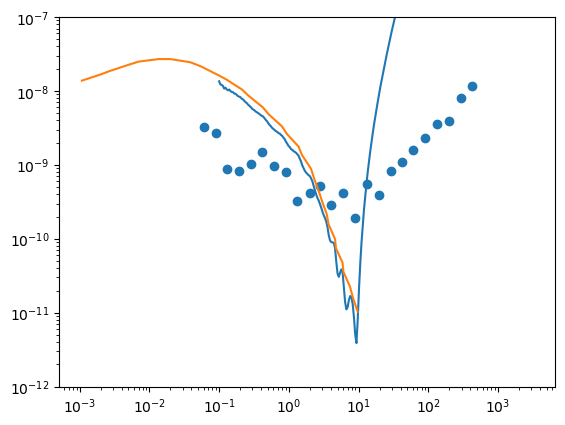

<function matplotlib.pyplot.show(close=None, block=None)>

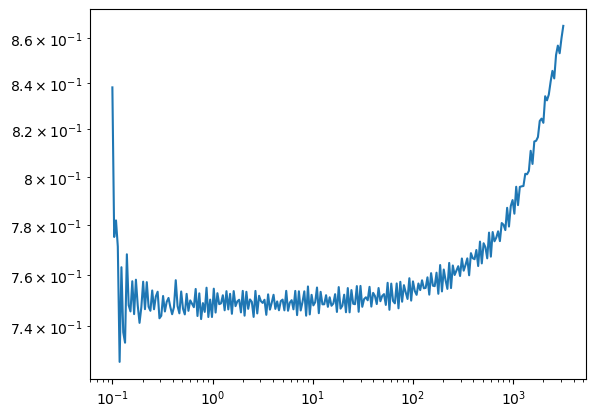

In [33]:
output = calculate_flux_product_with_energy(file='Murase_2211.04460/NGC1068cascadepg_300Rs.csv',mass=0.1,g=0.7,nsim=1,B0=1e5,rgam=1e-3,n0=1e9,Rjet=1e3)


plt.loglog(output[0],output[2].swapaxes(0,1))

file_path = 'Murase_2211.04460/NGC1068cascadepg_300Rs.csv'
flux_data = pd.read_csv(file_path)
x_values = flux_data['x']  # Photon energy
y_values = flux_data['Curve1']  # Flux of photons
plt.loglog(x_values,y_values)

plt.scatter(E_GeV_central,Flux_central)
plt.xscale('log')
plt.yscale('log')

plt.ylim(1e-12,1e-7)
plt.show()


plt.loglog(output[0],output[1].swapaxes(0,1))
plt.show